In [5]:
# parent dirs
parentdir = os.path.dirname(os.path.dirname(os.getcwd()))
data_path = f"{parentdir}/hackathon_2022"

Notebook Color Scheme:


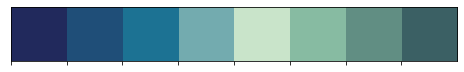

In [1]:
# Libraries
import os
import sys
#import wandb
import time
import random
from tqdm import tqdm
import warnings
import cv2
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib as mpl
import matplotlib.patches as patches
import matplotlib.pyplot as plt
from IPython.display import display_html
import imagesize
from sklearn.model_selection import StratifiedKFold

# Environment check
warnings.filterwarnings("ignore")
os.environ["WANDB_SILENT"] = "true"
CONFIG = {'competition': 'happywhale', '_wandb_kernel': 'aot'}

# Custom colors
class clr:
    S = '\033[1m' + '\033[96m'
    E = '\033[0m'
    
my_colors = ["#21295C", "#1F4E78", "#1C7293", "#73ABAF", "#C9E4CA", "#87BBA2", "#618E83", "#3B6064"]
print(clr.S+"Notebook Color Scheme:"+clr.E)
sns.palplot(sns.color_palette(my_colors))


In [6]:
# Create path to train images
TRAIN_PATH = f"{data_path}/train/"
train["path"] = TRAIN_PATH + train["image"]

In [16]:
TRAIN_PATH

'/home/ec2-user/SageMaker/hackathon_2022/train/'

In [7]:
print(clr.S+"Total Number of Samples:"+clr.E, len(os.listdir(f"{data_path}/test")), "\n")
print(clr.S+"--- TRAIN ---"+clr.E)
print(clr.S+"Total Number of Samples:"+clr.E, len(os.listdir(f"{data_path}/train")), "\n")

Total Number of Samples: 27956 

--- TRAIN ---
Total Number of Samples: 49836 



In [8]:
# Import the training data
train = pd.read_csv("train_minus_holdout.csv")

# # Adjust typos in "species" column
# train["species"] = train["species"].replace(["bottlenose_dolpin", "kiler_whale",
#                                              "beluga", 
#                                              "globis", "pilot_whale"],
#                                             ["bottlenose_dolphin", "killer_whale",
#                                              "beluga_whale", 
#                                              "short_finned_pilot_whale", "short_finned_pilot_whale"])
# # Create a "class" column
# train["class"] = train["species"].apply(lambda x: x.split("_")[-1])

# # Create path to train images
# TRAIN_PATH = "./train/"
# train["path"] = TRAIN_PATH + train["image"]


# --- Inspect ---
print(clr.S+"--- TEST ---"+clr.E)
print(clr.S+"Total Number of Samples:"+clr.E, len(os.listdir(f"{data_path}/test")), "\n")
print(clr.S+"--- TRAIN ---"+clr.E)
print(clr.S+"Total Number of Samples:"+clr.E, len(os.listdir(f"{data_path}/train")), "\n")
print(clr.S+"Number of Missing Values:"+clr.E, train.isna().sum().sum())
print(clr.S+"Data Shape:"+clr.E, train.shape)
train.head()



--- TEST ---
Total Number of Samples: 27956 

--- TRAIN ---
Total Number of Samples: 49836 

Number of Missing Values: 0
Data Shape: (49834, 5)


,image,species,individual_id,class,path
0,00021adfb725ed.jpg,melon_headed_whale,cadddb1636b9,whale,./train/00021adfb725ed.jpg
1,000562241d384d.jpg,humpback_whale,1a71fbb72250,whale,./train/000562241d384d.jpg
2,0007c33415ce37.jpg,false_killer_whale,60008f293a2b,whale,./train/0007c33415ce37.jpg
3,0007d9bca26a99.jpg,bottlenose_dolphin,4b00fe572063,dolphin,./train/0007d9bca26a99.jpg
4,00087baf5cef7a.jpg,humpback_whale,8e5253662392,whale,./train/00087baf5cef7a.jpg


In [19]:
train['path'] = train['path'].str.replace('./train/',TRAIN_PATH)


In [23]:
train['path'][0]

'/home/ec2-user/SageMaker/hackathon_2022/train/00021adfb725ed.jpg'

# Plotting some of the species

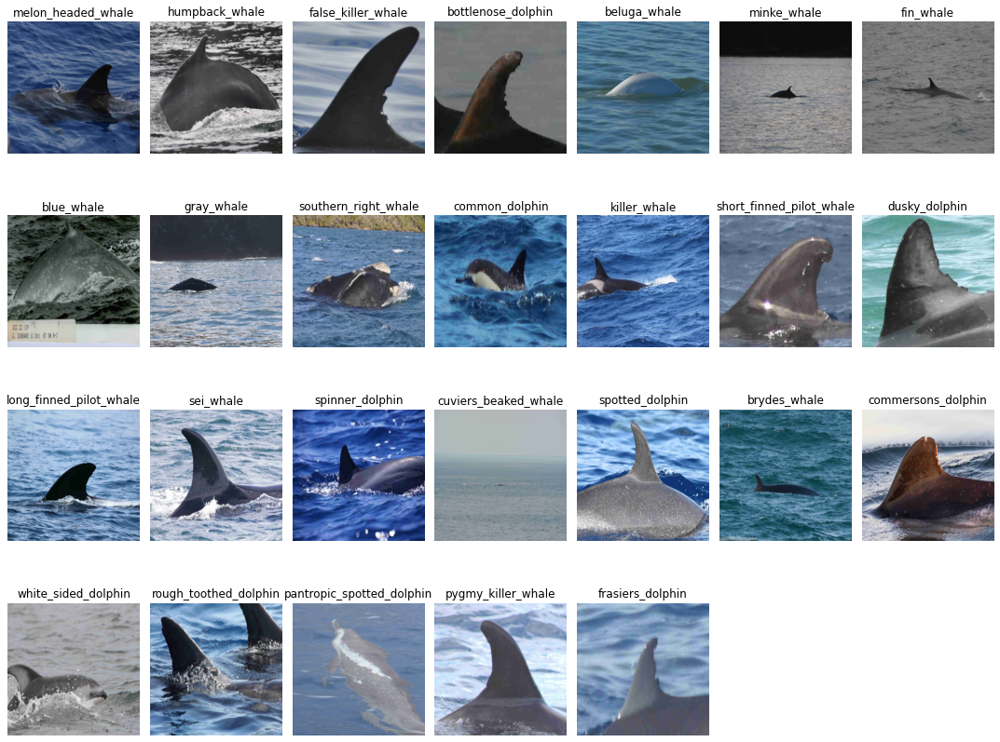

In [24]:
import random as rnd
from PIL import Image
plt.figure(figsize = (15,12))
for idx,i in enumerate(train.species.unique()):
    plt.subplot(4,7,idx+1)
    df = train[train['species'] ==i].reset_index(drop = True)
    image_path = df.loc[rnd.randint(0, len(df))-1,'path']
    img = Image.open(image_path)
    img = img.resize((224,224))
    plt.imshow(img)
    plt.axis('off')
    plt.title(i)
plt.tight_layout()
plt.show()

# Some more plotting of each specie

In [25]:
def plot_species(df,species_name):
    plt.figure(figsize = (12,12))
    species_df = df[df['species'] ==species_name].reset_index(drop = True)
    plt.suptitle(species_name)
    for idx,i in enumerate(np.random.choice(species_df['path'],32)):
        plt.subplot(8,8,idx+1)
        image_path = i
        img = Image.open(image_path)
        img = img.resize((224,224))
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.show()


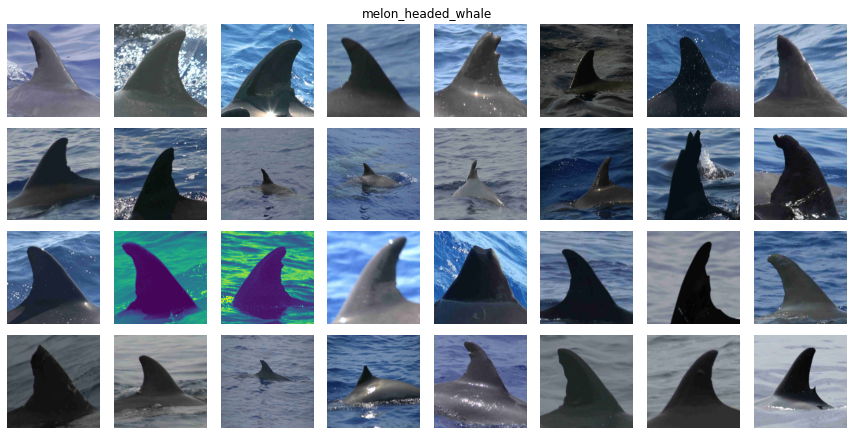

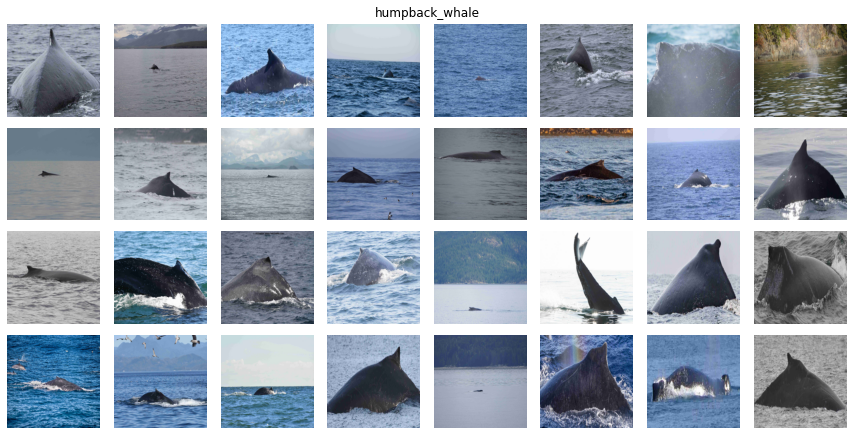

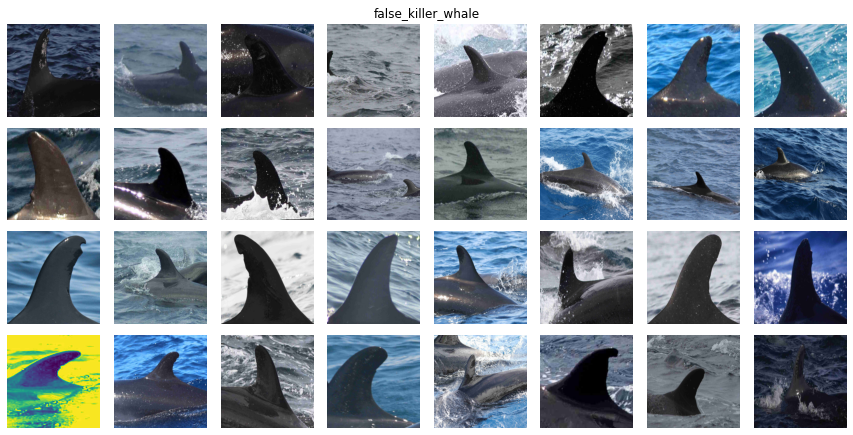

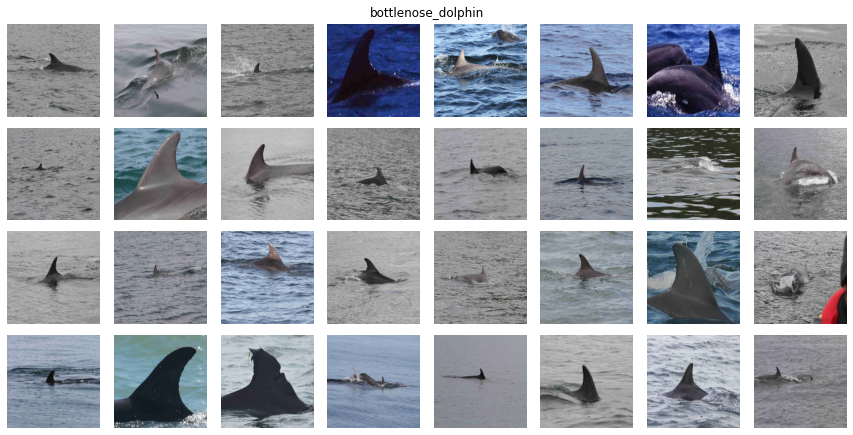

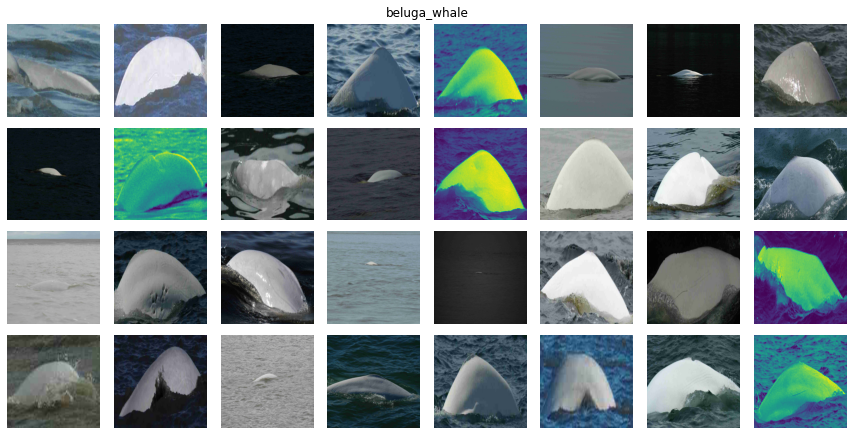

...

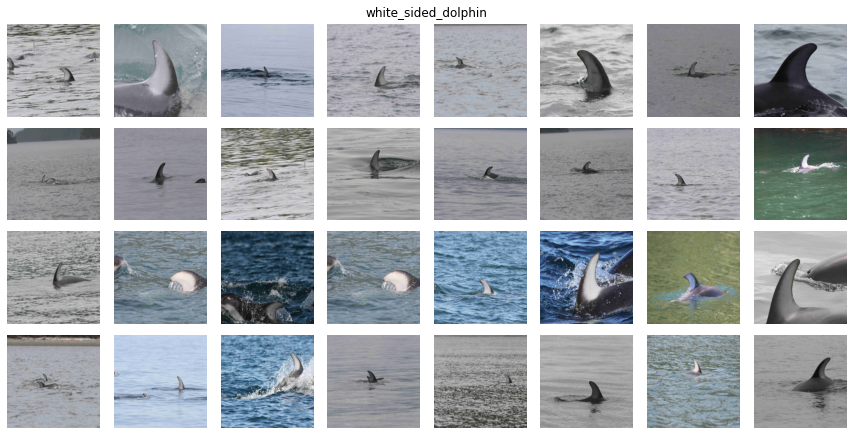

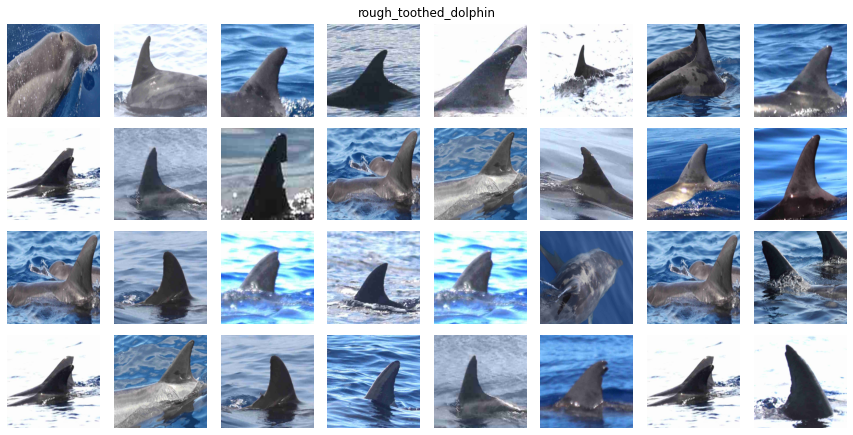

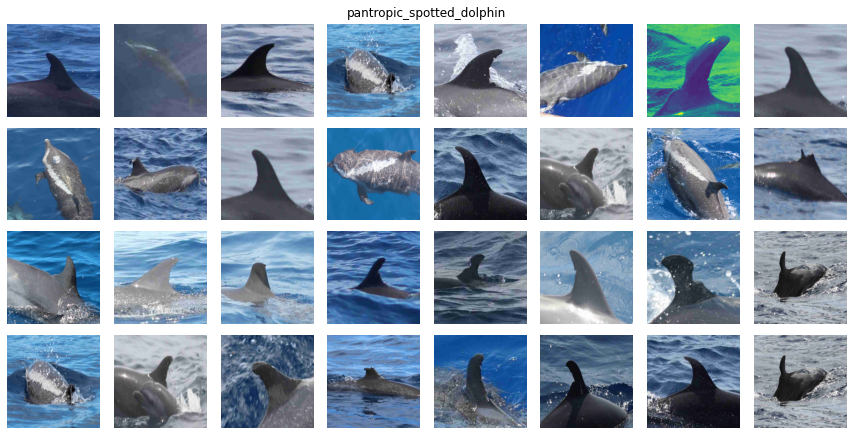

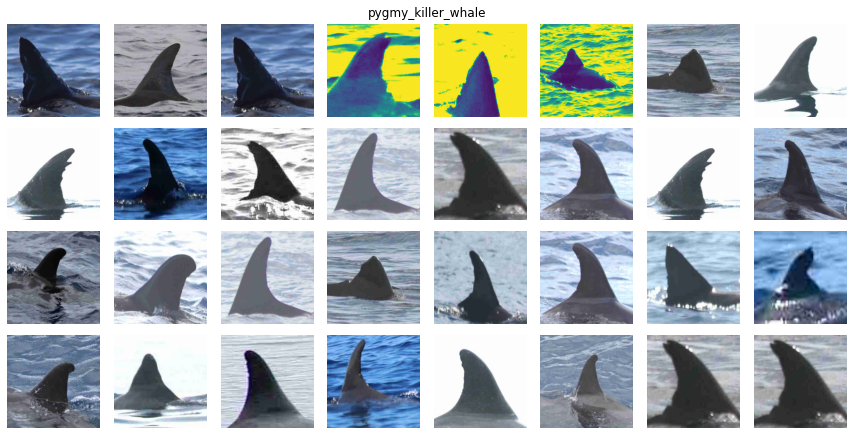

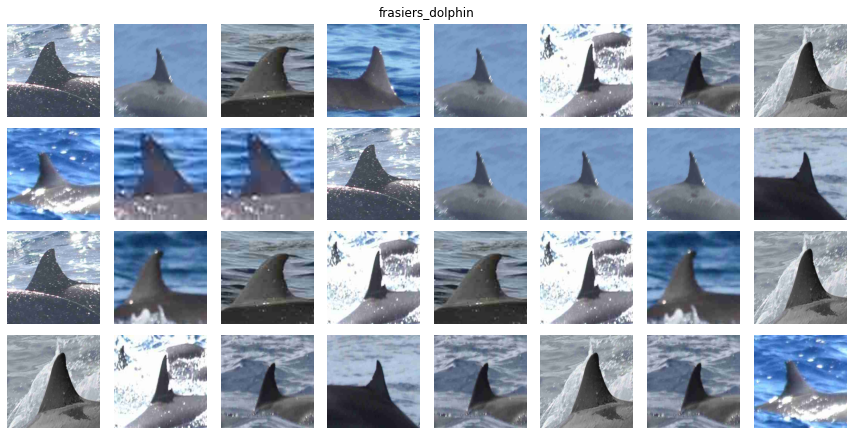

In [29]:
for species in train['species'].unique():
    #print('\n\n')
    plot_species(train , species)

# Plot the top 5 most common individuals

In [27]:
def plot_individual(df,individual_id):
    plt.figure(figsize = (12,12))
    species_df = df[df['individual_id'] ==individual_id].reset_index(drop = True)
    plt.suptitle(individual_id)
    for idx,i in enumerate(np.random.choice(species_df['path'],24)):
        plt.subplot(8,8,idx+1)
        image_path = i
        img = Image.open(image_path)
        img = img.resize((224,224))
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.show()


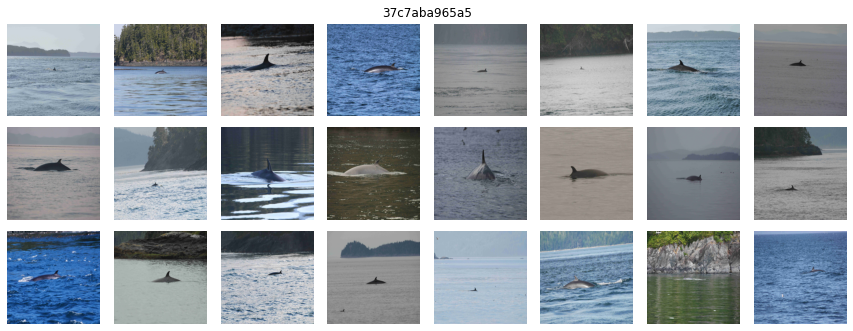

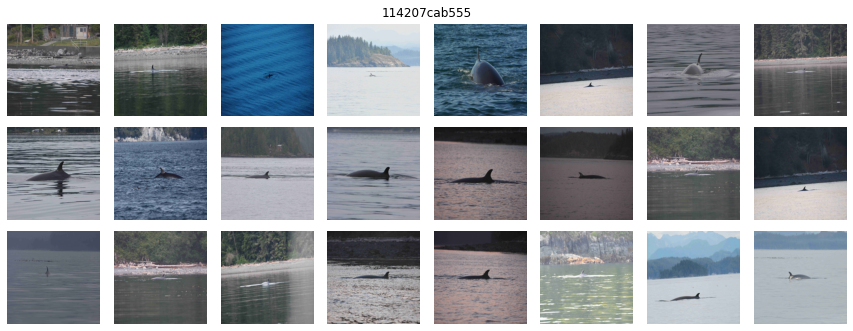

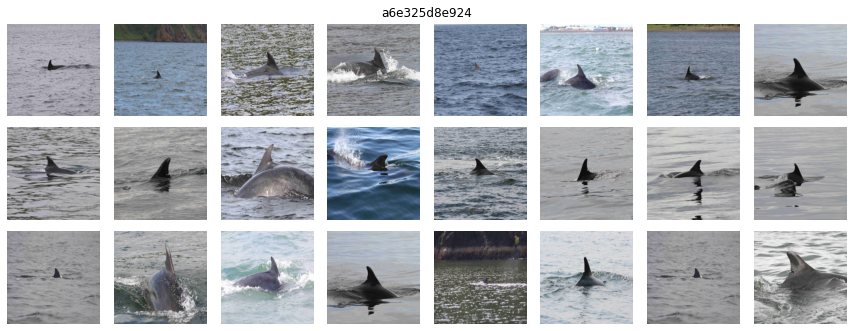

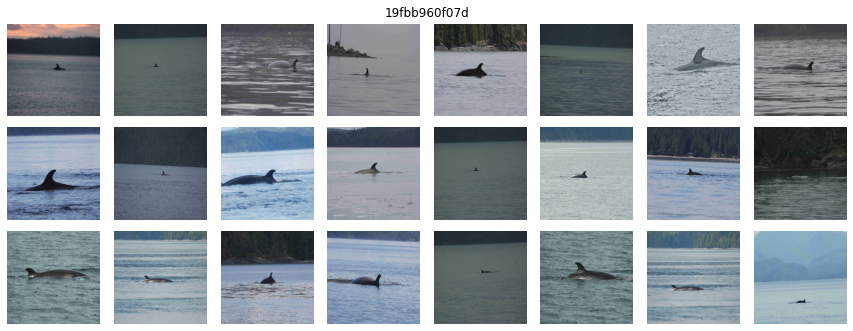

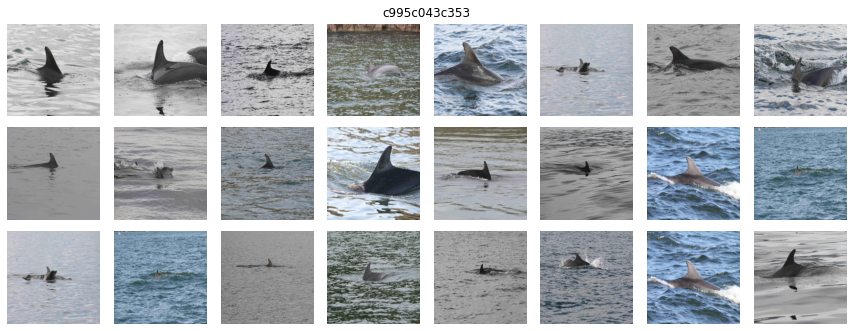

In [28]:
top_5_ids = train.individual_id.value_counts().head(5)
for i in top_5_ids.index:
    #print('\n\n')
    plot_individual(train , i)

In [31]:
train

,image,species,individual_id,class,path
0,00021adfb725ed.jpg,melon_headed_whale,cadddb1636b9,whale,/home/ec2-user/SageMaker/hackathon_2022/train/...
1,000562241d384d.jpg,humpback_whale,1a71fbb72250,whale,/home/ec2-user/SageMaker/hackathon_2022/train/...
2,0007c33415ce37.jpg,false_killer_whale,60008f293a2b,whale,/home/ec2-user/SageMaker/hackathon_2022/train/...
3,0007d9bca26a99.jpg,bottlenose_dolphin,4b00fe572063,dolphin,/home/ec2-user/SageMaker/hackathon_2022/train/...
4,00087baf5cef7a.jpg,humpback_whale,8e5253662392,whale,/home/ec2-user/SageMaker/hackathon_2022/train/...
...,...,...,...,...,...
49829,fff639a7a78b3f.jpg,beluga_whale,5ac053677ed1,whale,/home/ec2-user/SageMaker/hackathon_2022/train/...
49830,fff8b32daff17e.jpg,cuviers_beaked_whale,1184686361b3,whale,/home/ec2-user/SageMaker/hackathon_2022/train/...
49831,fff94675cc1aef.jpg,blue_whale,5401612696b9,whale,/home/ec2-user/SageMaker/hackathon_2022/train/...
49832,fffbc5dd642d8c.jpg,beluga_whale,4000b3d7c24e,whale,/home/ec2-user/SageMaker/hackathon_2022/train/...


# Split dataset in train and test set

In [37]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(train['image'], train['individual_id'], test_size=0.20, random_state=42)

In [45]:
# concatenate X_train and y_train into one dataframe
df_train = pd.concat([X_train, y_train])
# concatenate X_test and y_test into one dataframe
df_test = pd.concat([X_test, y_test])

In [46]:
df_train

7191     24cea3f0ab9761.jpg
33186    aae3585dca4f1a.jpg
938      050cf7ebbfb39b.jpg
33772    adcd8e5bdfa573.jpg
31755    a39c10a0482906.jpg
                ...        
11284          6d408c0e31ea
44732          281504409737
38158          0d1abe5be70d
860            9e1b81025c9d
15795          73e13d5e4ada
Length: 79734, dtype: object

In [47]:
df_test

12065    3e537c2291477b.jpg
4657     17c35701b67fdf.jpg
10539    3669fab4ccd24f.jpg
13602    463e50476b2826.jpg
38760    c79b5d3cd8f6ad.jpg
                ...        
29037          da1416bff528
18363          aa1fa573a5b5
4056           51239face0d2
29494          492a7ae943b6
20816          be330f0c495c
Length: 19934, dtype: object

# Plot some strange looking images

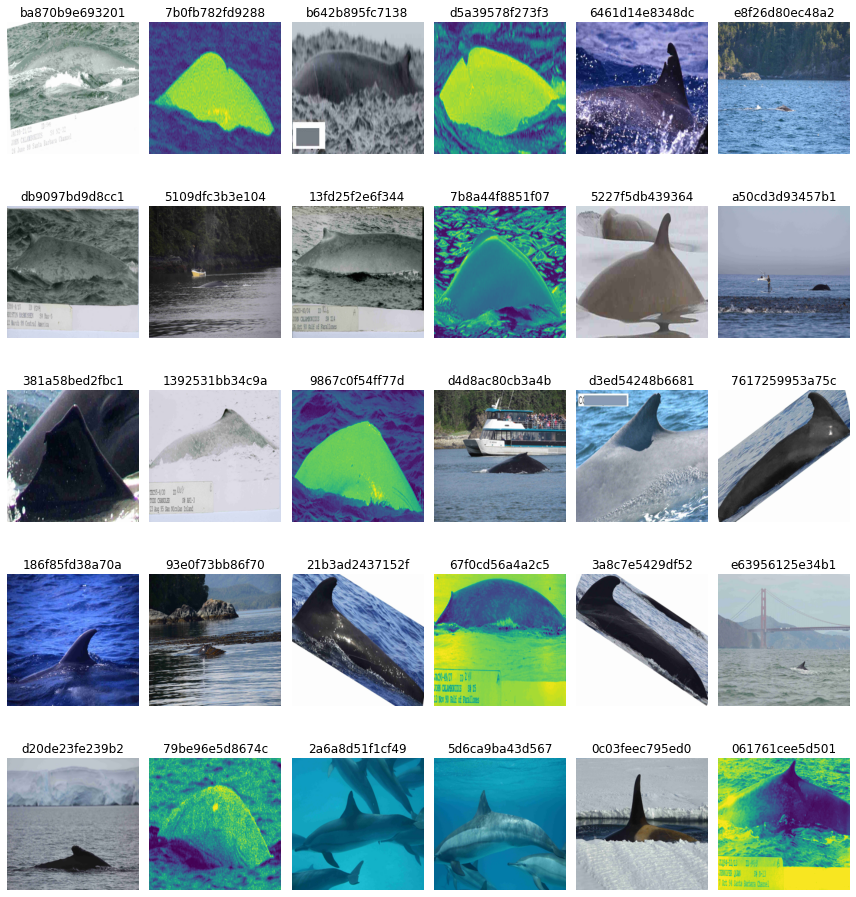

In [11]:
def plot_sometrainimages(image_ids, rows, cols):
    images = []
    
    plt.figure(figsize = (12,36))
    for idx,i in enumerate(image_ids):
        plt.subplot(rows,cols,idx+1)
        image_path = './train/' + i
        img = Image.open(image_path)
        img = img.resize((224,224))
        plt.title(i.split('.')[0])
        images.append(i)
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.show()
    
some_train_images = [
'ba870b9e693201.jpg','7b0fb782fd9288.jpg','b642b895fc7138.jpg','d5a39578f273f3.jpg','6461d14e8348dc.jpg','e8f26d80ec48a2.jpg',
'db9097bd9d8cc1.jpg','5109dfc3b3e104.jpg','13fd25f2e6f344.jpg','7b8a44f8851f07.jpg','5227f5db439364.jpg','a50cd3d93457b1.jpg', 
'381a58bed2fbc1.jpg','1392531bb34c9a.jpg','9867c0f54ff77d.jpg','d4d8ac80cb3a4b.jpg','d3ed54248b6681.jpg','7617259953a75c.jpg',
'186f85fd38a70a.jpg','93e0f73bb86f70.jpg','21b3ad2437152f.jpg','67f0cd56a4a2c5.jpg','3a8c7e5429df52.jpg','e63956125e34b1.jpg',
'd20de23fe239b2.jpg','79be96e5d8674c.jpg','2a6a8d51f1cf49.jpg','5d6ca9ba43d567.jpg','0c03feec795ed0.jpg','061761cee5d501.jpg'
]

plot_sometrainimages(some_train_images, 14, 6)



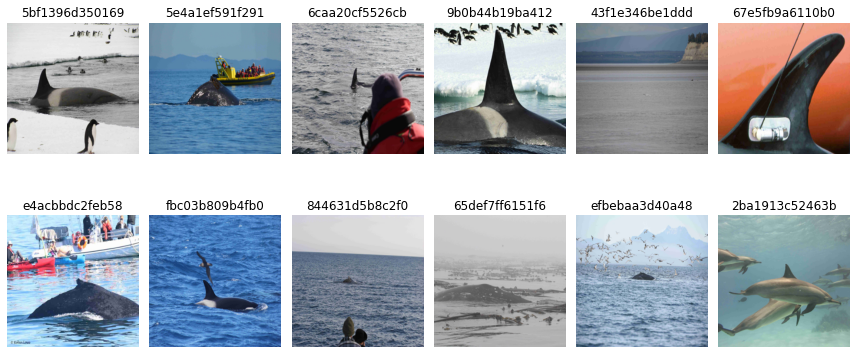

In [12]:
def plot_sometestimages(image_ids, rows, cols):
    images = []
    
    plt.figure(figsize = (12,6))
    for idx,i in enumerate(image_ids):
        plt.subplot(rows,cols,idx+1)
        image_path = './test/' + i
        img = Image.open(image_path)
        img = img.resize((224,224))
        plt.title(i.split('.')[0])
        images.append(i)
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

some_test_images = [
'5bf1396d350169.jpg','5e4a1ef591f291.jpg','6caa20cf5526cb.jpg','9b0b44b19ba412.jpg','43f1e346be1ddd.jpg','67e5fb9a6110b0.jpg',
'e4acbbdc2feb58.jpg','fbc03b809b4fb0.jpg','844631d5b8c2f0.jpg','65def7ff6151f6.jpg','efbebaa3d40a48.jpg','2ba1913c52463b.jpg',
]
plot_sometestimages(some_test_images, 2, 6)


# Plot the class distribution

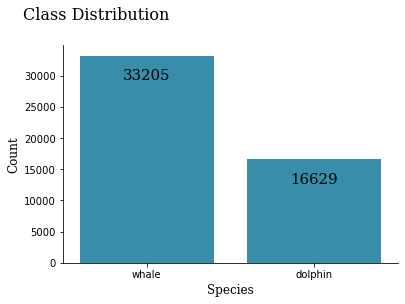

In [13]:
plot = sns.countplot(x = train['class'], color = '#2596be')
sns.despine()
plot.set_title('Class Distribution\n', font = 'serif', x = 0.1, y=1, fontsize = 16);
plot.set_ylabel("Count", x = 0.02, font = 'serif', fontsize = 12)
plot.set_xlabel("Species", fontsize = 12, font = 'serif')

for p in plot.patches:
    plot.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2, p.get_height()), 
       ha = 'center', va = 'center', xytext = (0, -20),font = 'serif', textcoords = 'offset points', size = 15)

# Plot the nr of pictures per specie

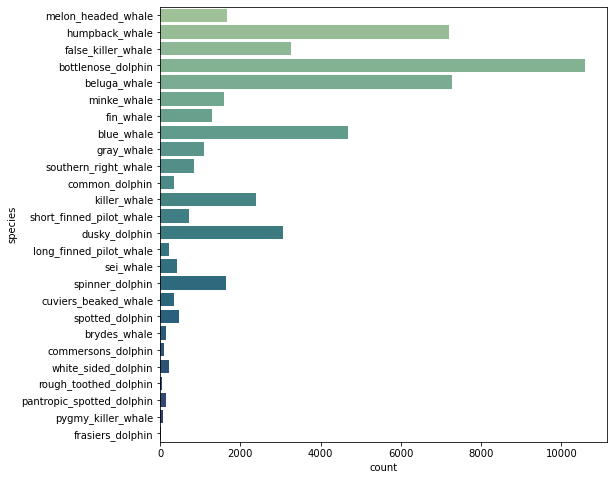

In [14]:
plt.figure(figsize=(8,8))
sns.countplot(data=train, y = 'species',  palette='crest', dodge=False)
plt.show()

# Interspecie member frequencies

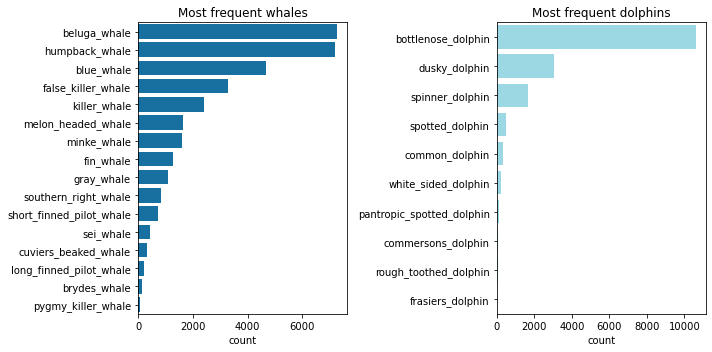

In [15]:
fig,ax = plt.subplots(1,2,figsize=(10,5))

whales = train[train['class']=='whale']
dolphins = train[train['class']!='whale']

sns.countplot(y="species", data=whales, order=whales.iloc[0:]["species"].value_counts().index, ax=ax[0], color = "#0077b6")
ax[0].set_title('Most frequent whales')
ax[0].set_ylabel(None)
    
sns.countplot(y="species", data=dolphins,order=dolphins.iloc[0:]["species"].value_counts().index, ax=ax[1], color = "#90e0ef")
ax[1].set_title('Most frequent dolphins')
ax[1].set_ylabel(None)

plt.tight_layout()
plt.show()


# Number of training images of top 10 individuals

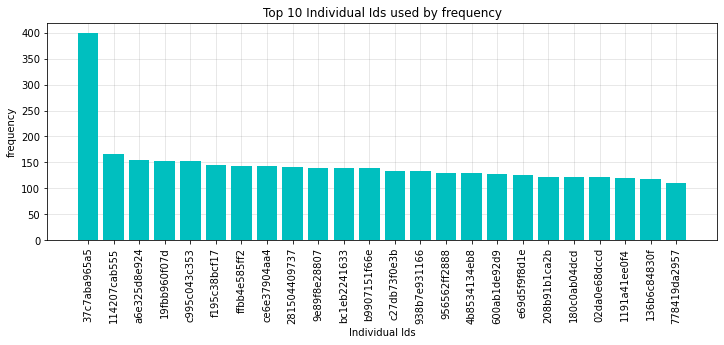

In [16]:
plt.figure(figsize=(12,4))
top_ten_ids = train.individual_id.value_counts().head(24)
top_ten_ids = pd.DataFrame({'individual_id':top_ten_ids.index, 'frequency':top_ten_ids.values})

plt.bar(top_ten_ids['individual_id'],top_ten_ids['frequency'],width = 0.8,color='c',zorder=4)
plt.xticks(rotation=90)
plt.ylabel("frequency")
plt.xlabel("Individual Ids")
plt.title("Top 10 Individual Ids used by frequency")
plt.grid(visible = True, color ='grey',linestyle ='-', linewidth = 0.9,alpha = 0.2, zorder=0)
plt.show()

# Density estimation of individual by whale and dolphin 

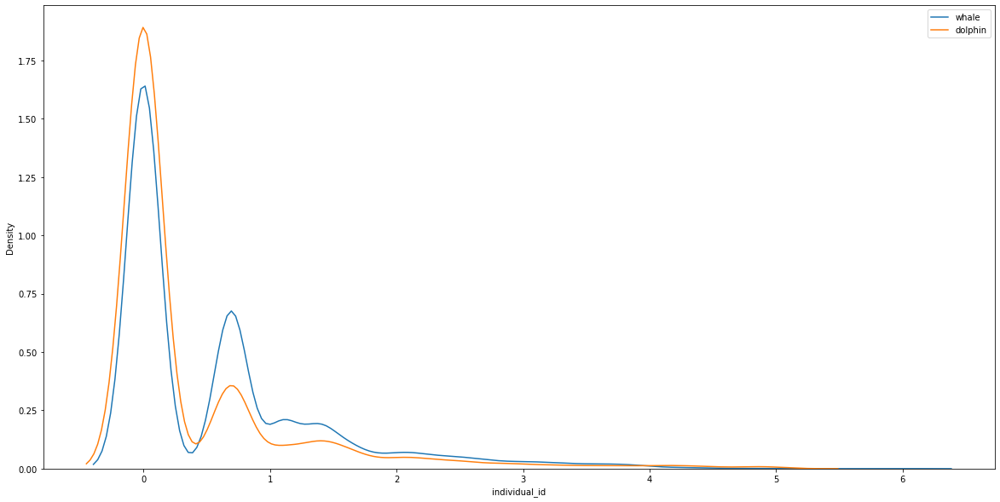

In [17]:
plt.figure(figsize = (20, 10))
sns.kdeplot(np.log(train.loc[train['class'] == 'whale']['individual_id'].value_counts()))
sns.kdeplot(np.log(train.loc[train['class'] == 'dolphin']['individual_id'].value_counts()))
plt.legend(labels = ['whale', 'dolphin'])
plt.show()

# Individuals with only one training image

In [18]:
train['count'] = train.groupby('individual_id',as_index=False)['individual_id'].transform(lambda x: x.count())
train[train['count']==1].shape[0]/len(train)

0.18471324798330457

# Percentage of Individuals with less then 5 images

In [19]:
tmp = train[train['count']<=4]
len(tmp)/len(train)



0.4074928763494803

# Percentage of Individuals with more then 4 and less then 21 images

In [21]:
count = 0
for i in train['count']:
    if(i > 4 and i <= 20):
        count += 1
print(count/len(train))


0.2332544046233495
